# Environmental Analytics Assignment

Author: Ross MacWilliam 

Student No: C17407712

Date: 27/04/2021

This is report contains a spatial database of wildfires that occured in the United States. Using this data, we will explore it using a variety of techniques and create interactive maps based on the data.

After that, we will inspect Satellite images of areas in America that have been impacted by wildfires in the past.

Finally, we will attempt to use an Air Temperature dataset from Kaggle to try to predict the size of a wildfire based on our wildfire dataset.

In [108]:
#import libraries

import sqlite3
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
import numpy as np
import folium
from folium import plugins
from folium.plugins import HeatMap
from pyproj import CRS
import shapely
import fiona
import requests
import geojson

import earthpy as et
import earthpy.spatial as es
import earthpy.plot as ep

import rasterio as rio
from rasterio.plot import show
from rasterio.mask import mask
import rioxarray as rxr

#connect to sqlite database
conn = sqlite3.connect('./data/FPA_FOD_20170508.sqlite')

In [109]:
# Specify the url for american states
url = "https://d2ad6b4ur7yvpq.cloudfront.net/naturalearth-3.3.0/ne_110m_admin_1_states_provinces_shp.geojson"

params = dict(service='WFS',
              request='GetFeature',
              outputFormat='json')

# Fetch data from WFS using requests
r = requests.get(url, params=params)

# Create GeoDataFrame from geojson
states = gpd.GeoDataFrame.from_features(geojson.loads(r.content))


#read the 'wildfires' table in to a pandas dataframe for sqlite db
df = pd.read_sql_query("SELECT * FROM Fires;", conn)
wildfires = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.LONGITUDE, df.LATITUDE))

pd.set_option('max_columns', None)

In [110]:
states.head()

,geometry,scalerank,adm1_code,diss_me,adm1_cod_1,iso_3166_2,wikipedia,sr_sov_a3,sr_adm0_a3,iso_a2,adm0_sr,admin0_lab,name,name_alt,name_local,type,type_en,code_local,code_hasc,note,hasc_maybe,region,region_cod,region_big,big_code,provnum_ne,gadm_level,check_me,scaleran_1,datarank,abbrev,postal,area_sqkm,sameascity,labelrank,featurec_1,admin,name_len,mapcolor9,mapcolor13,featureclass
0,"POLYGON ((-89.59941 48.01027, -89.48888 48.013...",2,USA-3514,3514,USA-3514,US-MN,http://en.wikipedia.org/wiki/Minnesota,US1,USA,US,1,2,Minnesota,MN|Minn.,None,State,State,US32,US.MN,None,None,Midwest,None,West North Central,None,0,1,10,2,1,Minn.,MN,0,-99,0,Admin-1 scale rank,United States of America,9,1,1,Admin-1 scale rank
1,"POLYGON ((-111.19419 44.56116, -111.29155 44.7...",2,USA-3515,3515,USA-3515,US-MT,http://en.wikipedia.org/wiki/Montana,US1,USA,US,1,2,Montana,MT|Mont.,None,State,State,US30,US.MT,None,None,West,None,Mountain,None,0,1,0,2,1,Mont.,MT,0,-99,0,Admin-1 scale rank,United States of America,7,1,1,Admin-1 scale rank
2,"POLYGON ((-96.60136 46.35136, -96.53891 46.199...",2,USA-3516,3516,USA-3516,US-ND,http://en.wikipedia.org/wiki/North_Dakota,US1,USA,US,1,2,North Dakota,ND|N.D.,None,State,State,US38,US.ND,None,None,Midwest,None,West North Central,None,0,1,0,2,1,N.D.,ND,0,-99,0,Admin-1 scale rank,United States of America,12,1,1,Admin-1 scale rank
3,"MULTIPOLYGON (((-155.93665 19.05939, -155.9080...",2,USA-3517,3517,USA-3517,US-HI,http://en.wikipedia.org/wiki/Hawaii,US1,USA,US,8,2,Hawaii,HI|Hawaii,None,State,State,US15,US.HI,None,None,West,None,Pacific,None,0,1,0,2,1,Hawaii,HI,0,-99,0,Admin-1 scale rank,United States of America,6,1,1,Admin-1 scale rank
4,"POLYGON ((-111.04973 44.48816, -111.05025 42.0...",2,USA-3518,3518,USA-3518,US-ID,http://en.wikipedia.org/wiki/Idaho,US1,USA,US,1,2,Idaho,ID|Idaho,None,State,State,US16,US.ID,None,None,West,None,Mountain,None,0,1,0,2,1,Idaho,ID,0,-99,0,Admin-1 scale rank,United States of America,5,1,1,Admin-1 scale rank


In [111]:
wildfires.head()

,OBJECTID,FOD_ID,FPA_ID,SOURCE_SYSTEM_TYPE,SOURCE_SYSTEM,NWCG_REPORTING_AGENCY,NWCG_REPORTING_UNIT_ID,NWCG_REPORTING_UNIT_NAME,SOURCE_REPORTING_UNIT,SOURCE_REPORTING_UNIT_NAME,LOCAL_FIRE_REPORT_ID,LOCAL_INCIDENT_ID,FIRE_CODE,FIRE_NAME,ICS_209_INCIDENT_NUMBER,ICS_209_NAME,MTBS_ID,MTBS_FIRE_NAME,COMPLEX_NAME,FIRE_YEAR,DISCOVERY_DATE,DISCOVERY_DOY,DISCOVERY_TIME,STAT_CAUSE_CODE,STAT_CAUSE_DESCR,CONT_DATE,CONT_DOY,CONT_TIME,FIRE_SIZE,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,OWNER_CODE,OWNER_DESCR,STATE,COUNTY,FIPS_CODE,FIPS_NAME,Shape,geometry
0,1,1,FS-1418826,FED,FS-FIRESTAT,FS,USCAPNF,Plumas National Forest,0511,Plumas National Forest,1,PNF-47,BJ8K,FOUNTAIN,None,None,None,None,None,2005,2453403.5,33,1300,9.0,Miscellaneous,2453403.5,33.0,1730,0.10,A,40.036944,-121.005833,5.0,USFS,CA,63,063,Plumas,b'\x00\x01\xad\x10\x00\x00\xe8d\xc2\x92_@^\xc0...,POINT (-121.00583 40.03694)
1,2,2,FS-1418827,FED,FS-FIRESTAT,FS,USCAENF,Eldorado National Forest,0503,Eldorado National Forest,13,13,AAC0,PIGEON,None,None,None,None,None,2004,2453137.5,133,0845,1.0,Lightning,2453137.5,133.0,1530,0.25,A,38.933056,-120.404444,5.0,USFS,CA,61,061,Placer,b'\x00\x01\xad\x10\x00\x00T\xb6\xeej\xe2\x19^\...,POINT (-120.40444 38.93306)
2,3,3,FS-1418835,FED,FS-FIRESTAT,FS,USCAENF,Eldorado National Forest,0503,Eldorado National Forest,27,021,A32W,SLACK,None,None,None,None,None,2004,2453156.5,152,1921,5.0,Debris Burning,2453156.5,152.0,2024,0.10,A,38.984167,-120.735556,13.0,STATE OR PRIVATE,CA,17,017,El Dorado,b'\x00\x01\xad\x10\x00\x00\xd0\xa5\xa0W\x13/^\...,POINT (-120.73556 38.98417)
3,4,4,FS-1418845,FED,FS-FIRESTAT,FS,USCAENF,Eldorado National Forest,0503,Eldorado National Forest,43,6,None,DEER,None,None,None,None,None,2004,2453184.5,180,1600,1.0,Lightning,2453189.5,185.0,1400,0.10,A,38.559167,-119.913333,5.0,USFS,CA,3,003,Alpine,b'\x00\x01\xad\x10\x00\x00\x94\xac\xa3\rt\xfa]...,POINT (-119.91333 38.55917)
4,5,5,FS-1418847,FED,FS-FIRESTAT,FS,USCAENF,Eldorado National Forest,0503,Eldorado National Forest,44,7,None,STEVENOT,None,None,None,None,None,2004,2453184.5,180,1600,1.0,Lightning,2453189.5,185.0,1200,0.10,A,38.559167,-119.933056,5.0,USFS,CA,3,003,Alpine,b'\x00\x01\xad\x10\x00\x00@\xe3\xaa.\xb7\xfb]\...,POINT (-119.93306 38.55917)


In [112]:
from shapely.geometry import Point

# Found easir way to do this!!

# Apply a Point using the latitude and longitude columns
#wildfires['geometry'] = wildfires.apply(lambda row: Point(row.LONGITUDE, row.LATITUDE), axis = 1)

#wildfires.head()

In [113]:
# Neither geodataframe have a crs yet
states.crs
wildfires.crs

In [114]:
states.crs = CRS.from_epsg(4326).to_wkt()
states.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [115]:
wildfires.crs = CRS.from_epsg(4326).to_wkt()
wildfires.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

## Explore data

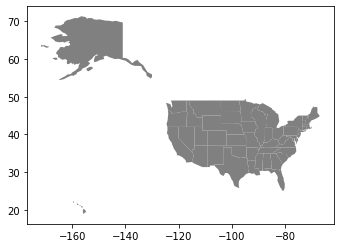

In [116]:
states.plot(facecolor='gray')

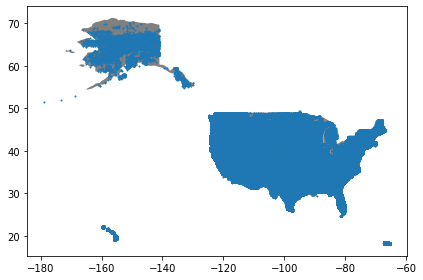

In [117]:
# Create a figure with one subplot
fig, ax = plt.subplots()

states.plot(ax=ax, facecolor='gray')

wildfires.plot(ax=ax, markersize=1)

plt.tight_layout()

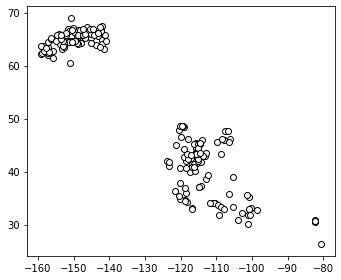

In [118]:
# We restrict to South America.
ax = wildfires[wildfires.FIRE_SIZE > 100000].plot(
    color='white', edgecolor='black')


plt.tight_layout()

In [119]:
# Make a geodataframe that contains all the largest wildfires in America
# Largest fires
big_fire = wildfires[wildfires.FIRE_SIZE > 100000]

# Join Geodataframes together
wild_polygon = gpd.sjoin(states, big_fire, op='contains')

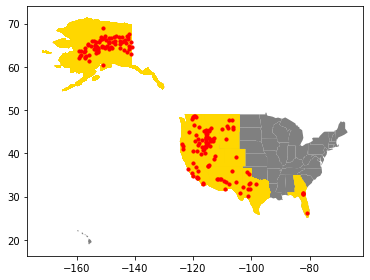

In [120]:
# Create a figure with one subplot
fig, ax = plt.subplots()

states.plot(ax=ax, facecolor='gray')

wild_polygon.plot(ax=ax, color='gold', markersize=2)

big_fire.plot(ax=ax, color='red', markersize=10)

plt.tight_layout()

# Heat Maps

In [121]:
heat_df = df[["LATITUDE","LONGITUDE", "FIRE_YEAR", "FIRE_SIZE"]]
# limit number of points, to get a processible result
heat_df = heat_df[heat_df["FIRE_SIZE"] > 1800] 
heat_df = heat_df.dropna(axis=0, subset=["LATITUDE","LONGITUDE"])

# List comprehension to make out list of lists
heat_data = [[row["LATITUDE"],row["LONGITUDE"]] for index, row in heat_df.iterrows()]
del heat_df

In [124]:
map_ = folium.Map(location=[df["LATITUDE"].mean(), df["LONGITUDE"].mean()],
                    tiles = "Stamen Terrain",                    
                    zoom_start = 3) 

# Plot it on the map
HeatMap(heat_data, min_opacity=.4).add_to(map_)

loc = 'Heat Map for Wildfires in America'
title_html = '''
             <h3 align="center" style="font-size:16px"><b>{}</b></h3>
             '''.format(loc)  

map_.get_root().html.add_child(folium.Element(title_html))

# Display the map
map_

Judging by the heat map and comparing it to the plot below, it  is obvious that the west coast of the US receives much more wildfires than the east coast.

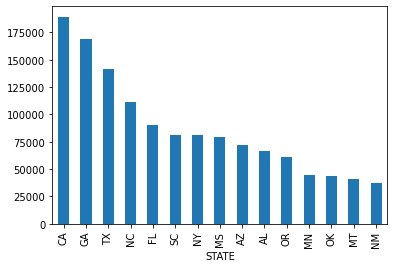

In [63]:
state_df = pd.read_sql_query("SELECT COUNT(OBJECTID) AS COUNT_INCIDENTS, State FROM Fires GROUP BY State;", conn)
state_df.set_index("STATE")["COUNT_INCIDENTS"].sort_values(ascending=False)[:15].plot(kind="bar");

In [64]:
#drop all fires < 1000 acres
wild_fire_size = wildfires.loc[wildfires['FIRE_SIZE'] > 1000]

x = len(df)

print(wild_fire_size.shape)

print ('The new dataframe is',
       round(len(wild_fire_size)/x * 100, 3), 
       '% of the original dataset')

(11087, 40)
The new dataframe is 0.59 % of the original dataset


In [65]:
# Tutorial followed to aid in the design for this was https://towardsdatascience.com/how-to-make-stunning-interactive-maps-with-python-and-folium-in-minutes-e3aff3b0ed43

def generate_color(size):
    if size <= 10000:
        c_outline, c_fill = '#ffda79', '#ffda79'
        m_opacity, f_opacity = 0.2, 1
        radius = np.log(size) * 0.5
    
    elif size > 10000 and size <= 50000:
        c_outline, c_fill = '#feb24c', '#feb24c'
        m_opacity, f_opacity = 0.4, 1
        radius = np.log(size) * 1
    
    elif size > 50000 and size <= 100000:
        c_outline, c_fill = '#fc4e2a', '#fc4e2a'
        m_opacity, f_opacity = 0.6, 1
        radius = np.log(size) * 1.5
    
    else : 
        c_outline, c_fill = '#b10026', '#b10026'
        m_opacity, f_opacity = 1, 1
        radius = np.log(size) * 2
    
    return c_outline, c_fill, m_opacity, f_opacity, radius

def generate_popup(name, size):
    return f'''<strong>Fire Name:</strong> {name}<br><strong>Size:</strong> {size} ac'''

## Interactive Folium Map

In [66]:
m = folium.Map(location = [40.44, -104.81],
               zoom_start = 6)

s_fire = folium.FeatureGroup(name = '< 10000 Acres')
m_fire = folium.FeatureGroup(name = '10,000 - 50,000 Acres')
l_fire = folium.FeatureGroup(name = '50,000 - 100,000 Acres')
xl_fire = folium.FeatureGroup(name = '> 100,000 Acres')

for _, row in wild_fire_size.iterrows():
    
    fire_size = float(row['FIRE_SIZE'])
    
    if fire_size < 10000:
        c_outline, c_fill, m_opacity, f_opacity, radius = generate_color(row['FIRE_SIZE'])
        folium.CircleMarker(
            location=[row['LATITUDE'], row['LONGITUDE']],
            popup=generate_popup(row['FIRE_NAME'], row['FIRE_SIZE']),
            color=c_outline,
            fill=True,
            fillColor=c_fill,
            opacity=m_opacity,
            fillOpacity=f_opacity,
            radius=radius
        ).add_to(s_fire)
    
    if fire_size >= 10000 and fire_size < 50000:
        c_outline, c_fill, m_opacity, f_opacity, radius = generate_color(row['FIRE_SIZE'])
        folium.CircleMarker(
            location=[row['LATITUDE'], row['LONGITUDE']],
            popup=generate_popup(row['FIRE_NAME'], row['FIRE_SIZE']),
            color=c_outline,
            fill=True,
            fillColor=c_fill,
            opacity=m_opacity,
            fillOpacity=f_opacity,
            radius=radius
        ).add_to(m_fire)
        
    if fire_size >= 50000 and fire_size < 100000:
        c_outline, c_fill, m_opacity, f_opacity, radius = generate_color(row['FIRE_SIZE'])
        folium.CircleMarker(
            location=[row['LATITUDE'], row['LONGITUDE']],
            popup=generate_popup(row['FIRE_NAME'], row['FIRE_SIZE']),
            color=c_outline,
            fill=True,
            fillColor=c_fill,
            opacity=m_opacity,
            fillOpacity=f_opacity,
            radius=radius
        ).add_to(l_fire)
        
    if fire_size > 100000:
        c_outline, c_fill, m_opacity, f_opacity, radius = generate_color(row['FIRE_SIZE'])
        folium.CircleMarker(
            location=[row['LATITUDE'], row['LONGITUDE']],
            popup=generate_popup(row['FIRE_NAME'], row['FIRE_SIZE']),
            color=c_outline,
            fill=True,
            fillColor=c_fill,
            opacity=m_opacity,
            fillOpacity=f_opacity,
            radius=radius
        ).add_to(xl_fire)

s_fire.add_to(m)
m_fire.add_to(m)
l_fire.add_to(m)
xl_fire.add_to(m)
folium.LayerControl(collapsed = False).add_to(m)

loc = 'Interactive Map for Wildfires in America'
title_html = '''
             <h3 align="center" style="font-size:16px"><b>{}</b></h3>
             '''.format(loc)  

m.get_root().html.add_child(folium.Element(title_html))

m

# Now we will take a deeper dive into wildfires in America using Satellite Images

In this analysis of wildfires, we are going to use satelite images taken of Cold Springs in Colorado after it's forests were ravaged by fire. The Cold Springs Fire started on July 12th, 2008, eleven miles from Trout Lake and it was eventually contained and put out in August 2008.

The fire was started by a Lightning Storm  that quickly spread through the dry timber that was spread across 7,993 acres of land. officials said that it was the largest fire that the area had had in decades, and the perfect conditions allowed it to quickly spread through the dead trees. Thankfully nobody died due to the fire, and now we are left with an interesting dataset that we can analyse.

In [67]:
naip_tif = rio.open(r"./data/cold-springs-fire/naip/m_3910505_nw_13_1_20150919/crop/m_3910505_nw_13_1_20150919_crop.tif")

naip = rxr.open_rasterio(naip_tif, masked=True)
naip

<xarray.DataArray (band: 4, y: 2312, x: 4377)>
[40478496 values with dtype=float64]
Coordinates:
  * band         (band) int32 1 2 3 4
  * y            (y) float64 4.427e+06 4.427e+06 ... 4.425e+06 4.425e+06
  * x            (x) float64 4.572e+05 4.572e+05 ... 4.615e+05 4.615e+05
    spatial_ref  int32 0
Attributes:
    STATISTICS_MAXIMUM:  239
    STATISTICS_MEAN:     nan
    STATISTICS_MINIMUM:  32
    STATISTICS_STDDEV:   nan
    scale_factor:        1.0
    add_offset:          0.0
    grid_mapping:        spatial_ref

Looking at this tif file, we know that it contains four bands. THese bands are made up of Red, Green, Blue, and Infrared. We can alternate the make up of an image using these bands to get it to show us the natural lighting to the vegetation in the image.

In [68]:
naip.shape

(4, 2312, 4377)

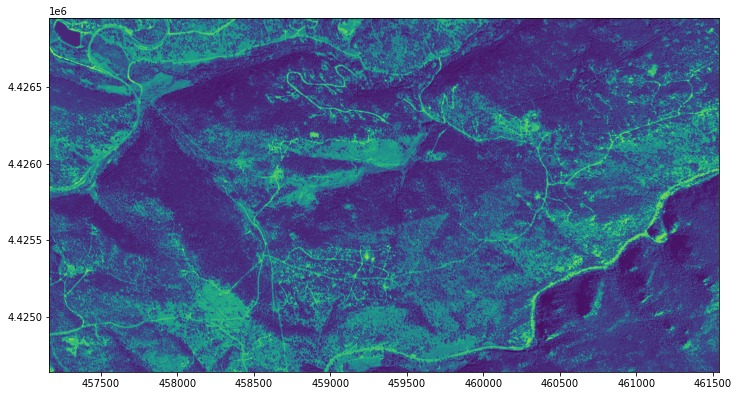

In [69]:
fig, ax = plt.subplots(1, figsize=(12, 10))
show(naip_tif, ax=ax)
plt.show()

Text(0.5, 1.0, 'Blue')

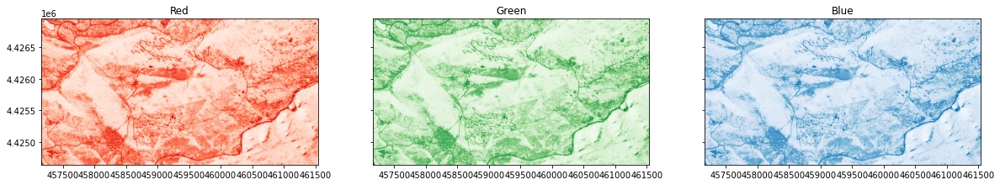

In [70]:
# display the different layers side by side
%matplotlib inline

# Initialize subplots
fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, nrows=1, figsize=(20, 10), sharey=True)

# Plot Red, Green and Blue (rgb)
show((naip_tif, 1), cmap='Reds', ax=ax1)
show((naip_tif, 1), cmap='Greens', ax=ax2)
show((naip_tif, 1), cmap='Blues', ax=ax3)

# Add titles
ax1.set_title("Red")
ax2.set_title("Green")
ax3.set_title("Blue")

# Normalising the satelite image

Normalising a satellite image allows us to reduce the radiometric influences caused by non-surface factors. This ensures that the grey value difference between temporal images reflect actual changes of the Earth sureface.

In [71]:
# Normalise bands into 0.0 - 1.0 scale
# this is done for the plotting of the image
def normalise(array):
    array_min, array_max = array.min(), array.max()
    return (array - array_min) / (array_max - array_min)

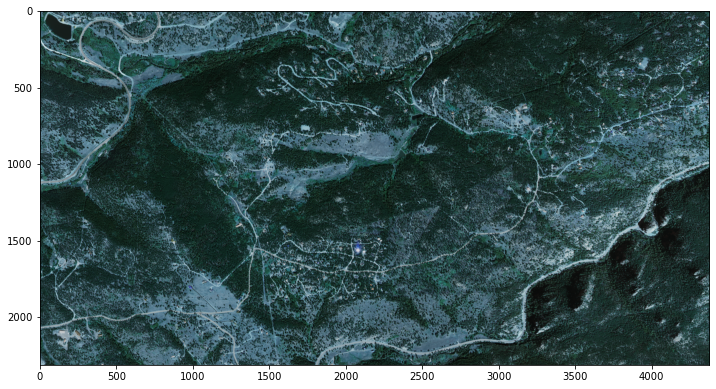

In [72]:
blue = naip_tif.read(3)
green = naip_tif.read(2)
red = naip_tif.read(1)

# Normalise band DN (this is done for the plotting in Python so that matlap can
# read the colour range correctly)
blue_norm = normalise(blue)
green_norm = normalise(green)
red_norm = normalise(red)

# Stack bands
rgb_cc = np.dstack((blue_norm, green_norm, red_norm))

# View the colour composite
plt.figure(figsize = (12,10))
plt.imshow(rgb_cc)

In [73]:
# let's also have a look at these new image values
print("Normalised bands:")
print(red_norm.min(), '-', red_norm.max(), 'mean:', red_norm.mean())
print(green_norm.min(), '-', green_norm.max(), 'mean:', green_norm.mean())
print(blue_norm.min(), '-', blue_norm.max(), 'mean:', blue_norm.mean())

Normalised bands:
0.0 - 1.0 mean: 0.27771054627906605
0.0 - 1.0 mean: 0.27303222758985807
0.0 - 1.0 mean: 0.1709558201658142


# Working with the Bands

In [74]:
# Bands
b1 = rio.open(r"./data/cold-springs-fire/landsat_collect/LC080340322016070701T1-SC20180214145604/crop/LC08_L1TP_034032_20160707_20170221_01_T1_sr_aerosol_crop.tif")
b2 = rio.open(r"./data/cold-springs-fire/landsat_collect/LC080340322016070701T1-SC20180214145604/crop/LC08_L1TP_034032_20160707_20170221_01_T1_sr_band2_crop.tif")
b3 = rio.open(r"./data/cold-springs-fire/landsat_collect/LC080340322016070701T1-SC20180214145604/crop/LC08_L1TP_034032_20160707_20170221_01_T1_sr_band3_crop.tif")
b4 = rio.open(r"./data/cold-springs-fire/landsat_collect/LC080340322016070701T1-SC20180214145604/crop/LC08_L1TP_034032_20160707_20170221_01_T1_sr_band4_crop.tif")
b5 = rio.open(r"./data/cold-springs-fire/landsat_collect/LC080340322016070701T1-SC20180214145604/crop/LC08_L1TP_034032_20160707_20170221_01_T1_sr_band5_crop.tif")
b6 = rio.open(r"./data/cold-springs-fire/landsat_collect/LC080340322016070701T1-SC20180214145604/crop/LC08_L1TP_034032_20160707_20170221_01_T1_sr_band6_crop.tif")
b7 = rio.open(r"./data/cold-springs-fire/landsat_collect/LC080340322016070701T1-SC20180214145604/crop/LC08_L1TP_034032_20160707_20170221_01_T1_sr_band7_crop.tif")
b8 = rio.open(r"./data/cold-springs-fire/landsat_collect/LC080340322016070701T1-SC20180214145604/crop/LC08_L1TP_034032_20160707_20170221_01_T1_pixel_qa_crop.tif")
b9 = rio.open(r"./data/cold-springs-fire/landsat_collect/LC080340322016070701T1-SC20180214145604/crop/LC08_L1TP_034032_20160707_20170221_01_T1_radsat_qa_crop.tif")

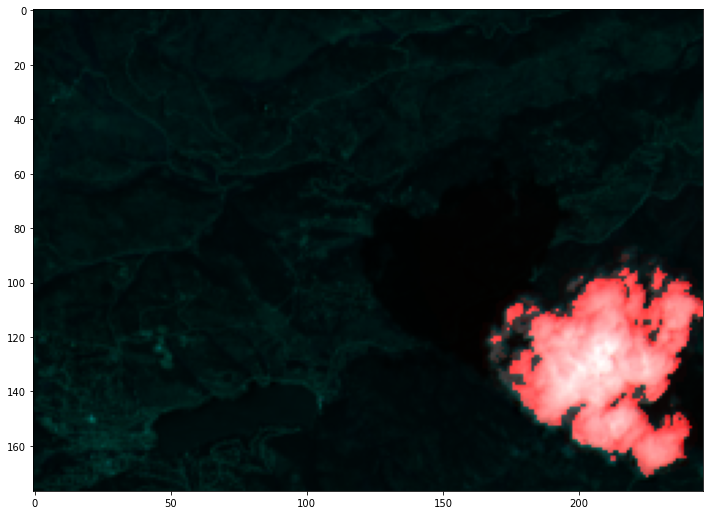

In [75]:
# this is the same principle as before:
# Read the grid values into numpy arrays
nir = b8.read(1)
red = b4.read(1)
green = b3.read(1)

# Normalise the values using the function that we defined earlier
nir_norm = normalise(nir)
red_norm = normalise(red)
green_norm = normalise(green)

# Create the composite by stacking
nrg = np.dstack((nir_norm, red_norm, green_norm))

# Let's see how our false colour composite looks like
plt.figure(figsize = (12,10))
plt.imshow(nrg)

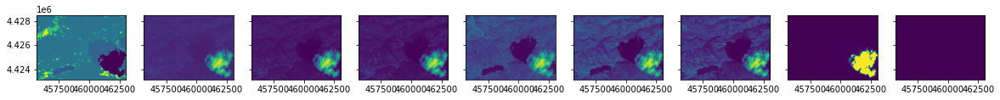

In [76]:
# display the different layers side by side
%matplotlib inline

# Initialize subplots
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9) = plt.subplots(ncols=9, nrows=1, figsize=(20, 10), sharey=True)

# Plot Red, Green and Blue (rgb)
show((b1, 1), ax=ax1)
show((b2, 1), ax=ax2)
show((b3, 1), ax=ax3)

show((b4, 1), ax=ax4)
show((b5, 1), ax=ax5)
show((b6, 1), ax=ax6)

show((b7, 1), ax=ax7)
show((b8, 1), ax=ax8)
show((b9, 1), ax=ax9)


## Calculating NDWI



We will NDWI using  the formula: (Band3 - Band8)/(Band3 + Band8).

In [77]:
green = b3.read(1)
nir = b8.read(1)

ndwi = (nir.astype(float)-green.astype(float))/(nir+green)

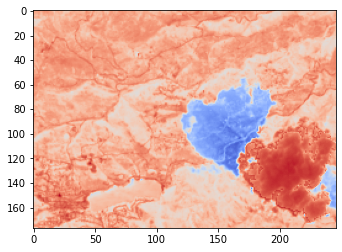

In [78]:
fig, ax = plt.subplots(1)
show(ndwi, ax=ax, cmap="coolwarm_r")
plt.show()

In [79]:
meta = b4.meta
meta

{'driver': 'GTiff',
 'dtype': 'int16',
 'nodata': -32768.0,
 'width': 246,
 'height': 177,
 'count': 1,
 'crs': CRS.from_epsg(32613),
 'transform': Affine(30.0, 0.0, 455655.0,
        0.0, -30.0, 4428465.0)}

In [80]:
meta.update(dtype=rio.float32)
meta

{'driver': 'GTiff',
 'dtype': 'float32',
 'nodata': -32768.0,
 'width': 246,
 'height': 177,
 'count': 1,
 'crs': CRS.from_epsg(32613),
 'transform': Affine(30.0, 0.0, 455655.0,
        0.0, -30.0, 4428465.0)}

# More Wildfire Satellite Imagery
As we said, looking at the folium maps we have made earlier, the west coast consumed most of the wildfires in America and particularily the North West. So from this we will use Landlook, an American satellite imaging GUI where we can find and create our own images of an are of our choice.

We will apply the same techniques to the next dataset pulled from https://landlook.usgs.gov/sentinel2/viewer.html.

This dataset is pulled from an area in Oregon, America called Lions Head, where there have been recent wildfires according to https://en.wikipedia.org/wiki/2020_Oregon_wildfires. This place was subjected to a wildfire caused by lightning and it grew so large that it merged with another wildfire in Beachie Creek Fire. The entire disaster resulted in 280 structures destroyed, and 10 injuries. The total area impacted was 402,000 acres of land and cost 25.2 million US dollars.

In [81]:
# First we will load in data gathered from landlook
tif_image = rio.open(r"./data/Oregon/_ags_8f69676a_d475_4fdf_ab84_a3dd5838465c.tif")

In [82]:
tif_image

<open DatasetReader name='./data/Oregon/_ags_8f69676a_d475_4fdf_ab84_a3dd5838465c.tif' mode='r'>

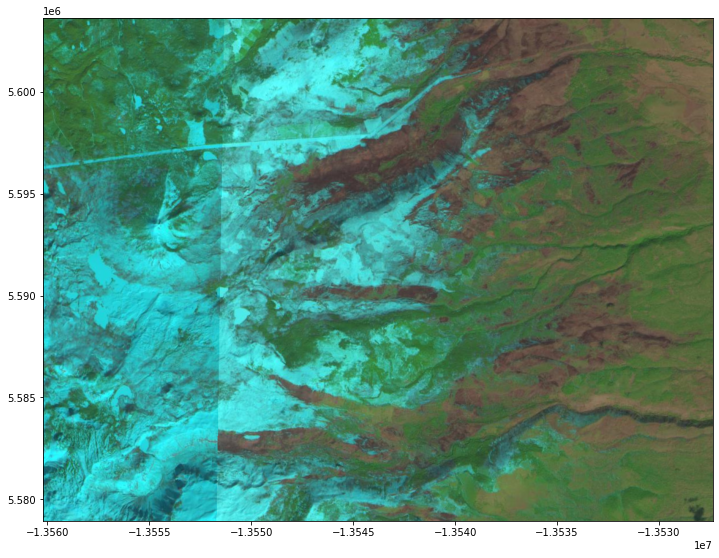

In [83]:
# Plot the area
fig, ax = plt.subplots(1, figsize=(12, 10))
show(tif_image, ax=ax)
plt.show()

Straight of the bat the area looks to include a mountain range that has some ice at the top. Lower down the range we can see both some green from vegetation growth and brown, probably scorched earth.

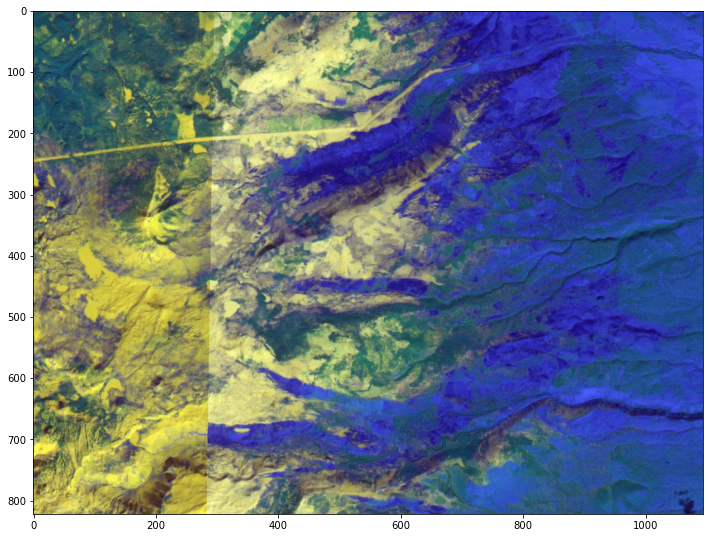

In [84]:
# Normalise bands into 0.0 - 1.0 scale
# this is done for the plotting of the image
def normalise(array):
    array_min, array_max = array.min(), array.max()
    return (array - array_min) / (array_max - array_min)

blue = tif_image.read(3)
green = tif_image.read(2)
red = tif_image.read(1)

# Normalise band DN (this is done for the plotting in Python so that matlap can
# read the colour range correctly)
blue_norm = normalise(blue)
green_norm = normalise(green)
red_norm = normalise(red)

# Stack bands
rgb_cc = np.dstack((blue_norm, green_norm, red_norm))

# View the colour composite
plt.figure(figsize = (12,10))
plt.imshow(rgb_cc)

In [85]:
lionshead_naip = rxr.open_rasterio(r"./data/Oregon/lionshead.tif", masked=True)

lionshead_naip

<xarray.DataArray (band: 3, y: 1644, x: 2188)>
[10791216 values with dtype=float64]
Coordinates:
  * band         (band) int32 1 2 3
  * y            (y) float64 5.603e+06 5.603e+06 ... 5.554e+06 5.554e+06
  * x            (x) float64 -1.358e+07 -1.358e+07 ... -1.351e+07 -1.351e+07
    spatial_ref  int32 0
Attributes:
    SourceBandIndex:  0
    scale_factor:     1.0
    add_offset:       0.0
    grid_mapping:     spatial_ref

Looking at this DataArray compared to the other one, we can see that this tif image has only come with three bands as opposed to the four like the other. This is somewhat unfortunate as we are missing the Near Infrared band so we can't go as indepth as we did with the previous image.

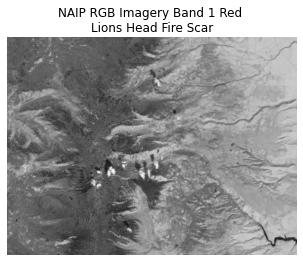

In [86]:
fig, ax = plt.subplots()

ax.imshow(lionshead_naip[0], 
          cmap="Greys_r")
ax.set_title("NAIP RGB Imagery Band 1 Red \nLions Head Fire Scar")
ax.set_axis_off()
plt.show()

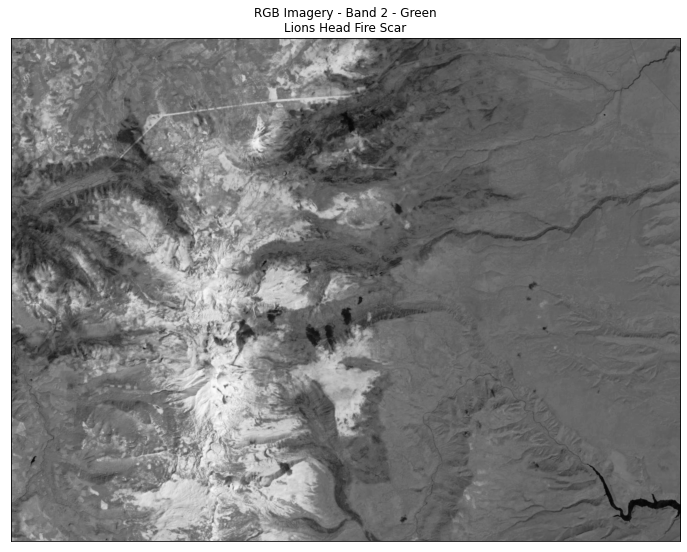

In [87]:
# Plot band 2 - green
ep.plot_bands(lionshead_naip[1],
              title="RGB Imagery - Band 2 - Green\nLions Head Fire Scar",
              cbar=False)
plt.show()

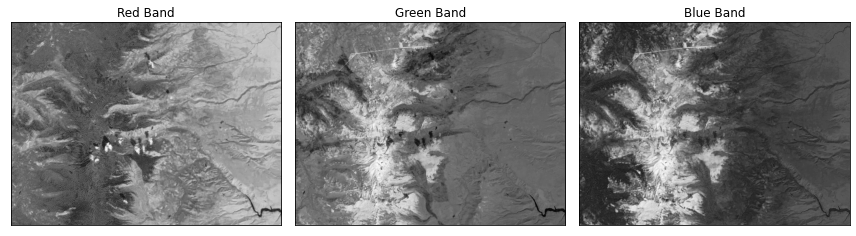

In [88]:
titles = ["Red Band", "Green Band", "Blue Band"]

# Plot all bands using the earthpy function
ep.plot_bands(lionshead_naip, 
              figsize=(12, 5), 
              cols=3,
              title=titles,
              cbar=False)
plt.show()

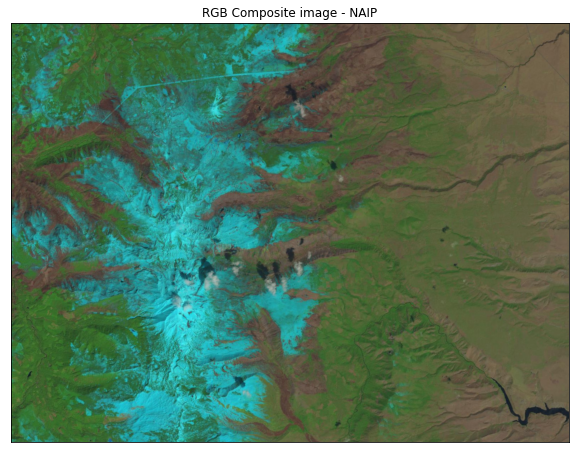

In [89]:
ep.plot_rgb(lionshead_naip.values,
            rgb=[0, 1, 2],
            title="RGB Composite image - NAIP")
plt.show()

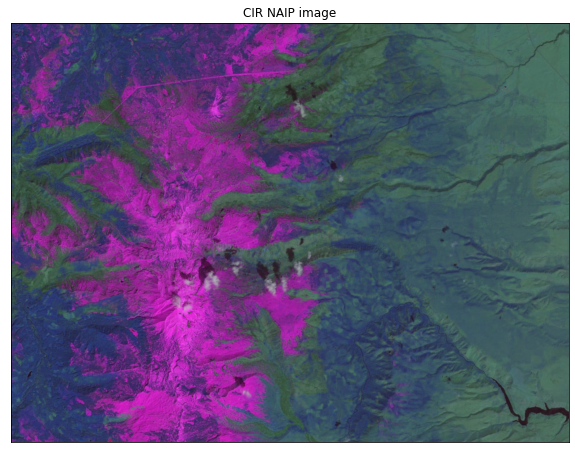

In [90]:
# This is just an idea of how we would switch the bands around to make up different images
ep.plot_rgb(lionshead_naip.values, title="CIR NAIP image",
            rgb=[2, 0, 1],
            figsize=(10, 8))
plt.show()

Landsat offers to download a 3 Std. Dev. Stretch too. It has a good representation of the vegetation, ice and earth. 

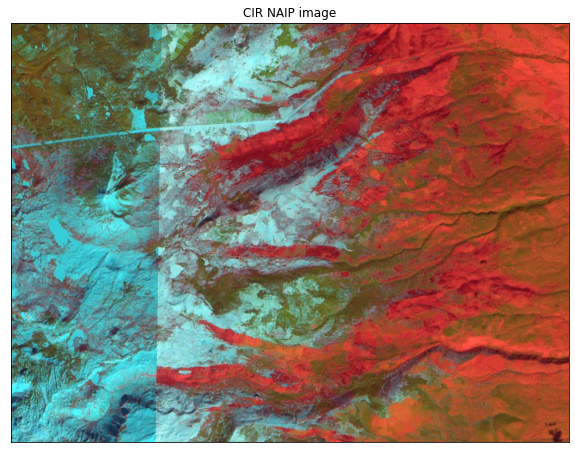

In [91]:
lionshead_cir_naip = rxr.open_rasterio(r"./data/Oregon/_ags_bdb95f67_1094_42bf_89fb_620b7d2fee97.tif", masked=True)

ep.plot_rgb(lionshead_cir_naip.values, title="CIR NAIP image",
            rgb=[0, 1, 2],
            figsize=(10, 8))
plt.show()

I couldn't find any downloadable data that contained all the necessary bands to portray the Lionshead wildfire landscape using Infrared. However, I did find a good website called 'sentinelhub Playground' that allowed me to generate images of the landscape at different time periods.

Here is an image taken of Lionshead in April 2019 and underneath it is an image of the same area in 2021.

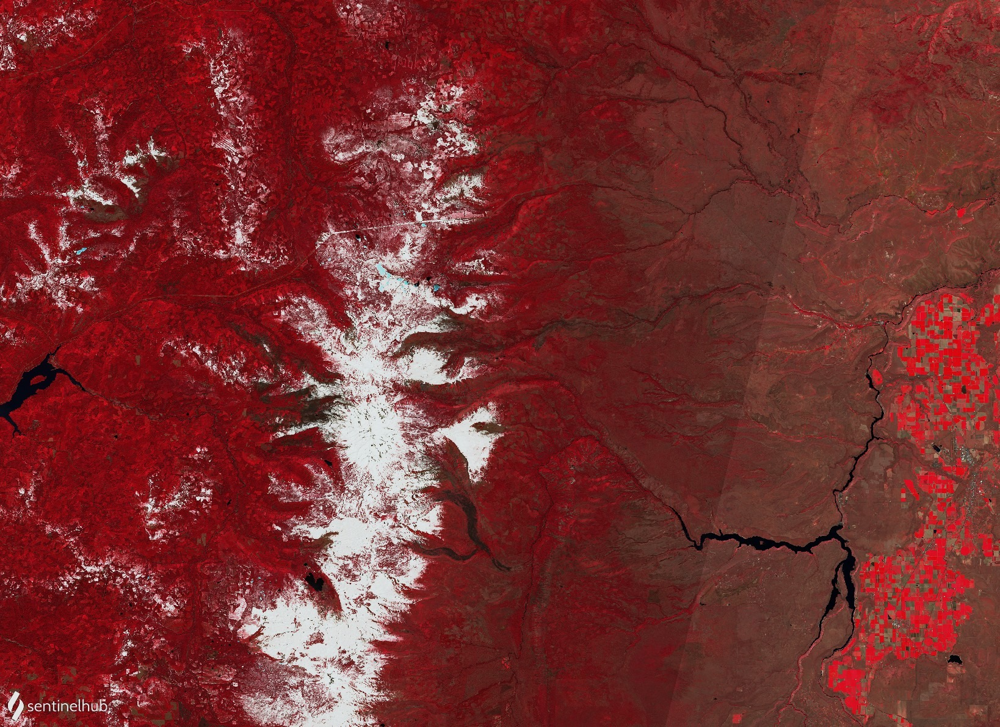

In [92]:
from IPython.display import Image

Image("./data/Oregon/colour-infrared-19.jpg")

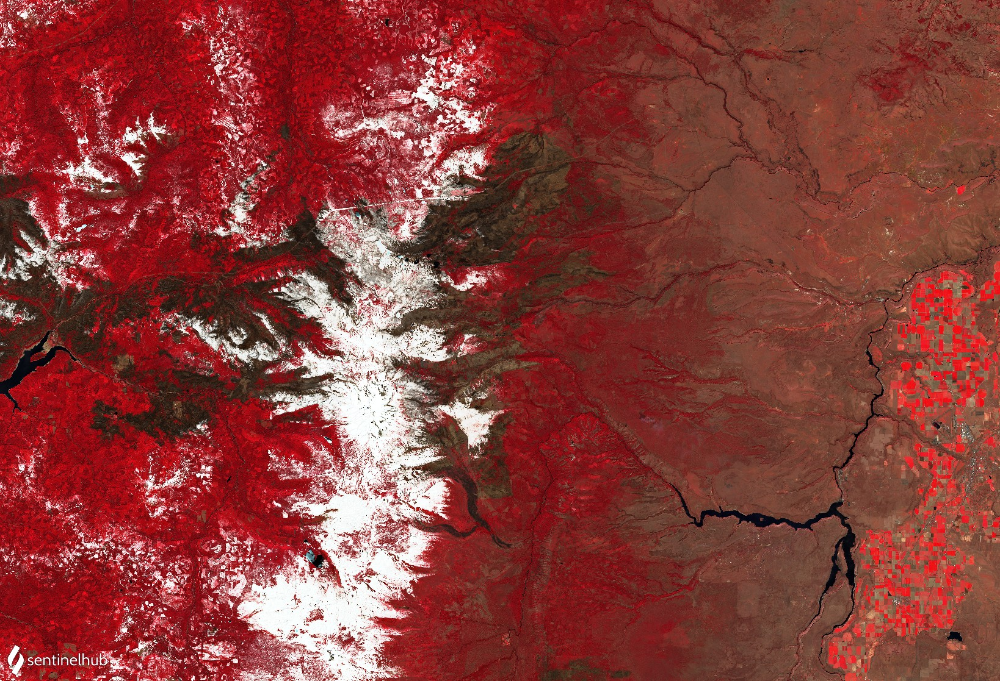

In [93]:
Image("./data/Oregon/colour-infrared-21.jpg")

Using this band make up clearly shows the devasting impact that the wildfire had on the vegetation in the area in the two years that they were taken.

# Using Air Temperature to Calculate the Size of a Wildfire


In this section of the report, we will import a dataset that includes the air temperature of cities around the world and investigate if we can use this as a predictor for the size of a wild fire. 

In [94]:
import datetime

In [95]:
global_temperatures = pd.read_csv('./data/GlobalLandTemperaturesByState.csv')
america_temp = global_temperatures.loc[global_temperatures['Country']=='United States']
america_temp['Date'] = pd.to_datetime(america_temp.dt)
america_temp = america_temp.loc[america_temp.Date.dt.year > 1996]

america_temp.head()

<ipython-input-95-d5f36d3cd3d7>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  america_temp['Date'] = pd.to_datetime(america_temp.dt)


,dt,AverageTemperature,AverageTemperatureUncertainty,State,Country,Date
10496,1997-01-01,7.821,0.123,Alabama,United States,1997-01-01
10497,1997-02-01,10.607,0.141,Alabama,United States,1997-02-01
10498,1997-03-01,16.418,0.225,Alabama,United States,1997-03-01
10499,1997-04-01,15.231,0.116,Alabama,United States,1997-04-01
10500,1997-05-01,20.063,0.226,Alabama,United States,1997-05-01


Due to the wildfire dataset including the state in an abbreviated form. We will use the imported US states dataset from earlier and merge it with the WildFire dataset to infer what state they happened in.

In [96]:
# Join Geodataframes together
wildfire_states = gpd.sjoin(states, wildfires, op='contains')
wildfire_states.head(2)

,geometry,scalerank,adm1_code,diss_me,adm1_cod_1,iso_3166_2,wikipedia,sr_sov_a3,sr_adm0_a3,iso_a2,adm0_sr,admin0_lab,name,name_alt,name_local,type,type_en,code_local,code_hasc,note,hasc_maybe,region,region_cod,region_big,big_code,provnum_ne,gadm_level,check_me,scaleran_1,datarank,abbrev,postal,area_sqkm,sameascity,labelrank,featurec_1,admin,name_len,mapcolor9,mapcolor13,featureclass,index_right,OBJECTID,FOD_ID,FPA_ID,SOURCE_SYSTEM_TYPE,SOURCE_SYSTEM,NWCG_REPORTING_AGENCY,NWCG_REPORTING_UNIT_ID,NWCG_REPORTING_UNIT_NAME,SOURCE_REPORTING_UNIT,SOURCE_REPORTING_UNIT_NAME,LOCAL_FIRE_REPORT_ID,LOCAL_INCIDENT_ID,FIRE_CODE,FIRE_NAME,ICS_209_INCIDENT_NUMBER,ICS_209_NAME,MTBS_ID,MTBS_FIRE_NAME,COMPLEX_NAME,FIRE_YEAR,DISCOVERY_DATE,DISCOVERY_DOY,DISCOVERY_TIME,STAT_CAUSE_CODE,STAT_CAUSE_DESCR,CONT_DATE,CONT_DOY,CONT_TIME,FIRE_SIZE,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,OWNER_CODE,OWNER_DESCR,STATE,COUNTY,FIPS_CODE,FIPS_NAME,Shape
0,"POLYGON ((-89.59941 48.01027, -89.48888 48.013...",2,USA-3514,3514,USA-3514,US-MN,http://en.wikipedia.org/wiki/Minnesota,US1,USA,US,1,2,Minnesota,MN|Minn.,None,State,State,US32,US.MN,None,None,Midwest,None,West North Central,None,0,1,10,2,1,Minn.,MN,0,-99,0,Admin-1 scale rank,United States of America,9,1,1,Admin-1 scale rank,146338,146339,147775,FS-374671,FED,FS-FIRESTAT,FS,USMNSUF,Superior National Forest,0909,Superior National Forest,29,None,0903,WINCHELL LAKE,None,None,None,None,None,2002,2452470.5,196,1115,1.0,Lightning,2452470.5,196.0,1740,0.3,B,47.980833,-90.660000,5.0,USFS,MN,None,None,None,b'\x00\x01\xad\x10\x00\x00\x08\xd7\xa3p=\xaaV\...
0,"POLYGON ((-89.59941 48.01027, -89.48888 48.013...",2,USA-3514,3514,USA-3514,US-MN,http://en.wikipedia.org/wiki/Minnesota,US1,USA,US,1,2,Minnesota,MN|Minn.,None,State,State,US32,US.MN,None,None,Midwest,None,West North Central,None,0,1,10,2,1,Minn.,MN,0,-99,0,Admin-1 scale rank,United States of America,9,1,1,Admin-1 scale rank,75131,75132,75999,FS-300667,FED,FS-FIRESTAT,FS,USMNSUF,Superior National Forest,0909,Superior National Forest,45,None,None,None,None,None,None,None,None,1994,2449579.5,227,1810,1.0,Lightning,2449580.5,228.0,1800,0.1,A,47.983333,-90.706667,5.0,USFS,MN,None,None,None,b'\x00\x01\xad\x10\x00\x00\xac4\xd7\x06:\xadV\...


In [97]:
# Extract necessary columns
fire_states = wildfire_states[['name', 'region', 'FIRE_YEAR', 'DISCOVERY_DATE','DISCOVERY_DOY', 'DISCOVERY_TIME', 'STAT_CAUSE_DESCR', 'FIRE_SIZE','FIRE_SIZE_CLASS', 'LATITUDE', 'LONGITUDE']]

# Convert year and start day of year to date
fire_states['Date'] = pd.to_datetime(wildfire_states['FIRE_YEAR'] * 1000 + wildfire_states['DISCOVERY_DOY'], format='%Y%j')

fire_states.head()

<ipython-input-97-b4b23f175ecf>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fire_states['Date'] = pd.to_datetime(wildfire_states['FIRE_YEAR'] * 1000 + wildfire_states['DISCOVERY_DOY'], format='%Y%j')


,name,region,FIRE_YEAR,DISCOVERY_DATE,DISCOVERY_DOY,DISCOVERY_TIME,STAT_CAUSE_DESCR,FIRE_SIZE,FIRE_SIZE_CLASS,LATITUDE,LONGITUDE,Date
0,Minnesota,Midwest,2002,2452470.5,196,1115,Lightning,0.3,B,47.980833,-90.660000,2002-07-15
0,Minnesota,Midwest,1994,2449579.5,227,1810,Lightning,0.1,A,47.983333,-90.706667,1994-08-15
0,Minnesota,Midwest,2005,2453575.5,205,1445,Lightning,5.0,B,47.983889,-90.413611,2005-07-24
0,Minnesota,Midwest,2005,2453583.5,213,1412,Smoking,0.1,A,47.985278,-90.707500,2005-08-01
0,Minnesota,Midwest,1995,2449888.5,171,1700,Lightning,1269.0,F,47.986667,-90.618333,1995-06-20


In [98]:
fire_data = fire_states[['Date', 'name', 'FIRE_SIZE_CLASS']]
temp_data = america_temp[['Date', 'State', 'AverageTemperature', 'AverageTemperatureUncertainty']]

ml_data = pd.merge(fire_data, temp_data, how='left', left_on=['Date', 'name'], right_on=['Date', 'State'])

ml_data = ml_data.dropna()
ml_data.head()

,Date,name,FIRE_SIZE_CLASS,State,AverageTemperature,AverageTemperatureUncertainty
3,2005-08-01,Minnesota,A,Minnesota,19.538,0.088
68,2008-05-01,Minnesota,B,Minnesota,11.043,0.170
79,1998-08-01,Minnesota,B,Minnesota,20.948,0.162
83,2006-11-01,Minnesota,A,Minnesota,0.237,0.168
94,1998-08-01,Minnesota,A,Minnesota,20.948,0.162
...,...,...,...,...,...,...
1847178,2012-06-01,Alaska,A,Alaska,10.354,0.415
1847182,2012-04-01,Alaska,A,Alaska,-3.599,0.394
1847226,2004-10-01,Alaska,A,Alaska,-2.530,0.271
1847248,2002-04-01,Alaska,A,Alaska,-6.725,0.280


In [99]:
X = ml_data[['AverageTemperature', 'AverageTemperatureUncertainty']]
y = ml_data[['FIRE_SIZE_CLASS']]

In [100]:
from sklearn.preprocessing import LabelEncoder

encoder = LabelEncoder()

encoded_y = encoder.fit(y)
encoded_y = encoder.transform(y)

encoded_y

C:\Users\RMacW\anaconda3\lib\site-packages\sklearn\utils\validation.py:73: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


array([0, 1, 1, ..., 0, 0, 1])

In [101]:
from sklearn.model_selection import train_test_split

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, encoded_y, test_size=0.2, random_state=12345)

In [102]:
from sklearn.model_selection import cross_val_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC

# KNearestNeighbors
knn_clf = KNeighborsClassifier()
knn_scores = cross_val_score(knn_clf, X_train, y_train, cv=3)
knn_mean = knn_scores.mean()

# Decision Tree
tree_clf = DecisionTreeClassifier()
tree_scores = cross_val_score(tree_clf, X_train, y_train, cv=3)
tree_mean = tree_scores.mean()

# Naives Bayes
nav_clf = GaussianNB()
nav_scores = cross_val_score(nav_clf, X_train, y_train, cv=3)
nav_mean = nav_scores.mean()

# Random Forest
rf = RandomForestRegressor(n_estimators = 7, random_state = 1)
forest_scores = cross_val_score(rf, X_train, y_train, cv=3)
for_mean = forest_scores.mean()

# Logistic Regression
lr = LogisticRegression(max_iter=100)
lr_scores = cross_val_score(lr, X_train, y_train)
lr_mean = lr_scores.mean()

# Create a Dataframe with the results.
d = {'Classifiers': ['KNN', 'Dec Tree','Naives Bayes', 'Random Forest', 'Logistic Regression'], 
    'Crossval Mean Scores': [knn_mean, tree_mean, nav_mean, for_mean, lr_mean]}

df_results = pd.DataFrame(data=d)

C:\Users\RMacW\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
C:\Users\RMacW\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_

In [103]:
print(df_results.sort_values(by='Crossval Mean Scores', ascending=False))

           Classifiers  Crossval Mean Scores
1             Dec Tree              0.568911
0                  KNN              0.544963
4  Logistic Regression              0.495548
2         Naives Bayes              0.494514
3        Random Forest              0.079515


Taking a look at the Crossval Mean Scores for these classifiers, we can't get much higher than 50%. After taking a look at the count for each incident, it is clear that a wild fire that is classed either 'A' or 'B', is far more likely than any other. We will need to train the classifiers to correct this issue.

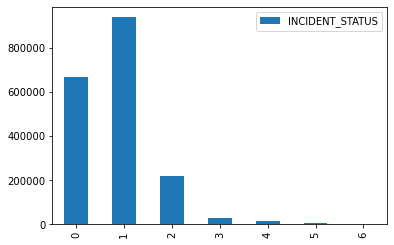

In [104]:
fire_status = pd.read_sql_query("SELECT COUNT(FIRE_SIZE_CLASS) AS INCIDENT_STATUS, FIRE_SIZE_CLASS FROM Fires GROUP BY FIRE_SIZE_CLASS;", conn)
fire_status.plot(kind="bar");

In [105]:
from sklearn.tree import DecisionTreeClassifier
classifier = DecisionTreeClassifier(class_weight=None, 
                                    criterion='entropy', 
                                    max_depth=None,
                                    max_features=None, 
                                    max_leaf_nodes=None,
                                    min_impurity_split=1e-07, 
                                    min_samples_leaf=1,
                                    min_samples_split=2, 
                                    min_weight_fraction_leaf=0.0,
                                    presort=False, 
                                    random_state=None, 
                                    splitter='best')
classifier.fit(X_train, y_train)

C:\Users\RMacW\anaconda3\lib\site-packages\sklearn\tree\_classes.py:306: FutureWarning: The min_impurity_split parameter is deprecated. Its default value has changed from 1e-7 to 0 in version 0.23, and it will be removed in 0.25. Use the min_impurity_decrease parameter instead.
  warnings.warn("The min_impurity_split parameter is deprecated. "
C:\Users\RMacW\anaconda3\lib\site-packages\sklearn\tree\_classes.py:323: FutureWarning: The parameter 'presort' is deprecated and has no effect. It will be removed in v0.24. You can suppress this warning by not passing any value to the 'presort' parameter.
  warnings.warn("The parameter 'presort' is deprecated and has no "


DecisionTreeClassifier(criterion='entropy', min_impurity_split=1e-07,
                       presort=False)

In [106]:
y_pred = classifier.predict(X_test)

In [107]:
from sklearn.metrics import classification_report, confusion_matrix
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))

[[1891  991   32    1    4    0    0]
 [1053 2865  125    2    1    0    0]
 [ 175  733   63    3    2    0    0]
 [  40   85    9    1    0    0    0]
 [  34   56    4    0    1    0    0]
 [  12   25    1    0    0    0    0]
 [   6   10    2    0    0    0    0]]
              precision    recall  f1-score   support

           0       0.59      0.65      0.62      2919
           1       0.60      0.71      0.65      4046
           2       0.27      0.06      0.10       976
           3       0.14      0.01      0.01       135
           4       0.12      0.01      0.02        95
           5       0.00      0.00      0.00        38
           6       0.00      0.00      0.00        18

    accuracy                           0.59      8227
   macro avg       0.25      0.21      0.20      8227
weighted avg       0.54      0.59      0.55      8227



C:\Users\RMacW\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Accuracy is used when the True Positives and True negatives are more important while F1-score is used when the False Negatives and False Positives are crucial. Due to our imbalanced class distribution, we will use the F-1score as it is a better metric to evaluate our model.

The Decision Tree came out with the highest accuracy in a our comparison  of models, so after rerunning the classifier with the classification report the model comes out with an accuracy of 59%. This isn't a great result, and I certainly wouldn't be using this model to try accurately predict the class of a wild fire should it come up.